# Spilled Secrets: Uncovering the Effects of Oil Spills on the North Sea Ecosystem

### By: Ryan Boarman


Two main data sources were used for this exploratory analysis. Oil slick locations and species distribution maps. 

Oil slicks were provided by SkyTruth. SkyTruth’s project Cerulean is an algorithm designed to detect oil slicks using Synthetic Aperture Radar (SAR) imagery. The algorithm scans Sentinel-1 SAR imagery with a focus on vertical polarization emitted and received (VV) for dark, smooth areas that indicate oil slicks. SAR imagery is useful for this purpose because of its ability to penetrate clouds and its 6-day temporal resolution, allowing for timely and frequent acquisition of images. Additionally, the contrast between the surface scattering of radar pulses off the small wavelets in clean water versus the smoother, darker appearance of oil slicks on radar images makes SAR imagery a useful tool for detecting oil spills (SkyTruth, 2023). I received oil slicks from 2020 in the North Sea, for this proof of concept and work flow I used only oil slicks from August 2020. I filtered the oil slick by category to only included "Infrastructure", "Vessel Old", "Recent", and "Adjacent.

Species distribution maps used in this analysis are from Waggitt et al. 2019. Waggit et al. generated monthly distribution maps of cetaceans and seabirds. A comprehensive survey of the North-East Atlantic was conducted between 1980 and 2018, collecting 2.68 million km of data. The data was collated and standardized and used to create distribution maps for 12 cetacean and 12 seabird species. These maps are at a resolution of 10 km and are at a monthly temporal scale.

Data was preprocessed and filtered to the study areas spatial and temporal resolution. For this initial analysis oil spills in the month of August and one species distribution in August, Harbour porpoise, was selected for the analysis. After data cleaning, zonal statistics were generated from each oil spill resulting in an average animal per km2 value for each oil spill.

*SkyTruth, 2023, https://skytruth.org*

*Waggitt, J. J., Evans, P. G., Andrade, J., Banks, A. N., Boisseau, O., Bolton, M., ... & Hiddink, J. G. (2020). Distribution maps of cetacean and seabird populations in the North‐East Atlantic. Journal of Applied Ecology, 57(2), 253-269.*


# Import libraries and set working directory to current directory

In [1]:
# Standard library imports
import calendar
import os
import re

# Third-party imports
import earthpy
import folium
import geopandas as gpd
from ipywidgets import Dropdown, IntSlider, interact, widgets
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
import rasterio
import requests
import rioxarray as rxr

# Local imports
from my_functions import calculate_geometry_stats, download_oil_data


In [2]:
# Get the current working directory.
working_dir = os.getcwd()

# Download data

### Oil Slick data download

In [3]:
# URLs for data sources.
base_url = ("https://github.com/ryanboarman/boarman-2023-capstone-project/"
            "releases/download/v1.0.0/")

germany_url = base_url + "germany_slicks.geojson"
finland_url = base_url + "finland_slicks.geojson"
norway_url = base_url + "norway_slicks.geojson"
sweden_url = base_url + "sweden_slicks.geojson"
uk_url = base_url + "uk_slicks.geojson"

# Corresponding filenames for the data sources.
germany_filename = "germany_slicks.geojson"
finland_filename = "finland_slicks.geojson"
norway_filename = "norway_slicks.geojson"
sweden_filename = "sweden_slicks.geojson"
uk_filename = "uk_slicks.geojson"

# Lists to manage multiple URLs and filenames.
oil_urls = [germany_url, finland_url, norway_url, sweden_url, uk_url]
oil_filenames = [germany_filename, finland_filename,
                 norway_filename, sweden_filename, uk_filename]

# Download the data.
download_oil_data(oil_urls, oil_filenames)
print("All files downloaded.")

All files downloaded.


### Species distribution data download

#### Species distribution data list creation

In [4]:
species_data_list = [

    {'MERP_EUR_RazorbillFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RazorbillFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_SpermWhaleFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_SpermWhaleFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_MinkeWhaleFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_MinkeWhaleFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernFulmarFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernFulmarFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_ManxShearwaterFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_ManxShearwaterFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_FinWhaleFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_FinWhaleFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanShagFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanShagFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_BlackLeggedKittiwakeFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BlackLeggedKittiwakeFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_StripedDolphinFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_StripedDolphinFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitesidedDolphinFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitesidedDolphinFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_LesserBlackBackedGullFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_LesserBlackBackedGullFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_PilotWhaleFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_PilotWhaleFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_RissosDolphinFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RissosDolphinFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitebeakedDolphinFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitebeakedDolphinFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_GreatSkuaFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_GreatSkuaFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_KillerWhaleFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_KillerWhaleFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_AtlanticPuffinFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_AtlanticPuffinFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_HarbourPorpoiseFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HarbourPorpoiseFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_KillerWhaleFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_KillerWhaleFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitebeakedDolphinFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitebeakedDolphinFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_MinkeWhaleFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_MinkeWhaleFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernFulmarFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernFulmarFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_AtlanticPuffinFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_AtlanticPuffinFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanShagFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanShagFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_StripedDolphinFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_StripedDolphinFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonGuillemotFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonGuillemotFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanStormPetrelFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanStormPetrelFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_BottlenoseDolphinFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BottlenoseDolphinFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_PilotWhaleFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_PilotWhaleFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_LesserBlackBackedGullFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_LesserBlackBackedGullFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitesidedDolphinFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitesidedDolphinFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_RissosDolphinFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RissosDolphinFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_BlackLeggedKittiwakeFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BlackLeggedKittiwakeFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_FinWhaleFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_FinWhaleFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_RazorbillFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RazorbillFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_SpermWhaleFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_SpermWhaleFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_GreatSkuaFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_GreatSkuaFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_RazorbillFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RazorbillFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernFulmarFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernFulmarFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_MinkeWhaleFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_MinkeWhaleFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_SpermWhaleFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_SpermWhaleFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_BottlenoseDolphinFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BottlenoseDolphinFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_HerringGullFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HerringGullFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanShagFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanShagFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_FinWhaleFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_FinWhaleFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanStormPetrelFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanStormPetrelFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_BlackLeggedKittiwakeFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BlackLeggedKittiwakeFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_StripedDolphinFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_StripedDolphinFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_LesserBlackBackedGullFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_LesserBlackBackedGullFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonDolphinFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonDolphinFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_PilotWhaleFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_PilotWhaleFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_KillerWhaleFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_KillerWhaleFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitebeakedDolphinFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitebeakedDolphinFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_GreatSkuaFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_GreatSkuaFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernGannetFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernGannetFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_HarbourPorpoiseFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HarbourPorpoiseFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_AtlanticPuffinFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_AtlanticPuffinFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitebeakedDolphinFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitebeakedDolphinFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_KillerWhaleFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_KillerWhaleFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_AtlanticPuffinFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_AtlanticPuffinFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernFulmarFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernFulmarFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_MinkeWhaleFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_MinkeWhaleFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_StripedDolphinFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_StripedDolphinFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanShagFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanShagFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanStormPetrelFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanStormPetrelFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_PilotWhaleFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_PilotWhaleFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_BottlenoseDolphinFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BottlenoseDolphinFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitesidedDolphinFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitesidedDolphinFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_LesserBlackBackedGullFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_LesserBlackBackedGullFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_RissosDolphinFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RissosDolphinFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_FinWhaleFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_FinWhaleFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_BlackLeggedKittiwakeFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BlackLeggedKittiwakeFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_RazorbillFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RazorbillFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_HarbourPorpoiseFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HarbourPorpoiseFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_SpermWhaleFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_SpermWhaleFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_GreatSkuaFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_GreatSkuaFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_ManxShearwaterFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_ManxShearwaterFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_BottlenoseDolphinFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BottlenoseDolphinFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanStormPetrelFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanStormPetrelFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_HerringGullFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HerringGullFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_FinWhaleFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_FinWhaleFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_BlackLeggedKittiwakeFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BlackLeggedKittiwakeFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonGuillemotFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonGuillemotFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonDolphinFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonDolphinFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_RissosDolphinFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RissosDolphinFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_PilotWhaleFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_PilotWhaleFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_LesserBlackBackedGullFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_LesserBlackBackedGullFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitesidedDolphinFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitesidedDolphinFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_KillerWhaleFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_KillerWhaleFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_GreatSkuaFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_GreatSkuaFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernGannetFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernGannetFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_HarbourPorpoiseFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HarbourPorpoiseFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernGannetFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernGannetFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitebeakedDolphinFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitebeakedDolphinFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernFulmarFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernFulmarFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_MinkeWhaleFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_MinkeWhaleFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanStormPetrelFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanStormPetrelFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonGuillemotFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonGuillemotFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanShagFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanShagFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_BottlenoseDolphinFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BottlenoseDolphinFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonDolphinFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonDolphinFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_RissosDolphinFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RissosDolphinFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitesidedDolphinFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitesidedDolphinFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_LesserBlackBackedGullFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_LesserBlackBackedGullFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_BlackLeggedKittiwakeFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BlackLeggedKittiwakeFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_HerringGullFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HerringGullFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_SpermWhaleFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_SpermWhaleFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_HarbourPorpoiseFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HarbourPorpoiseFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_ManxShearwaterFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_ManxShearwaterFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_GreatSkuaFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_GreatSkuaFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_MinkeWhaleFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_MinkeWhaleFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernFulmarFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernFulmarFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_RazorbillFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RazorbillFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_ManxShearwaterFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_ManxShearwaterFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_BottlenoseDolphinFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BottlenoseDolphinFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanStormPetrelFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanStormPetrelFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_HerringGullFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HerringGullFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanShagFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanShagFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonGuillemotFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonGuillemotFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_StripedDolphinFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_StripedDolphinFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_RissosDolphinFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RissosDolphinFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonDolphinFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonDolphinFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitesidedDolphinFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitesidedDolphinFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernGannetFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernGannetFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_GreatSkuaFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_GreatSkuaFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_AtlanticPuffinFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_AtlanticPuffinFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_HarbourPorpoiseFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HarbourPorpoiseFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernGannetFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernGannetFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_MinkeWhaleFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_MinkeWhaleFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernFulmarFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernFulmarFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanStormPetrelFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanStormPetrelFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanShagFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanShagFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonGuillemotFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonGuillemotFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonDolphinFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonDolphinFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_BottlenoseDolphinFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BottlenoseDolphinFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_RissosDolphinFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RissosDolphinFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_LesserBlackBackedGullFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_LesserBlackBackedGullFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitesidedDolphinFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitesidedDolphinFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_HerringGullFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HerringGullFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_BlackLeggedKittiwakeFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BlackLeggedKittiwakeFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_HarbourPorpoiseFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HarbourPorpoiseFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_ManxShearwaterFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_ManxShearwaterFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_BlackLeggedKittiwakeFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BlackLeggedKittiwakeFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_StripedDolphinFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_StripedDolphinFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_LesserBlackBackedGullFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_LesserBlackBackedGullFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitesidedDolphinFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitesidedDolphinFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_RissosDolphinFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RissosDolphinFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_PilotWhaleFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_PilotWhaleFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_KillerWhaleFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_KillerWhaleFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_SpermWhaleFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_SpermWhaleFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_AtlanticPuffinFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_AtlanticPuffinFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_RazorbillFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RazorbillFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernFulmarFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernFulmarFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_MinkeWhaleFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_MinkeWhaleFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitebeakedDolphinFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitebeakedDolphinFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_GreatSkuaFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_GreatSkuaFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_ManxShearwaterFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_ManxShearwaterFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonGuillemotFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonGuillemotFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_FinWhaleFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_FinWhaleFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanShagFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanShagFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_PilotWhaleFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_PilotWhaleFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonDolphinFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonDolphinFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanShagFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanShagFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_StripedDolphinFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_StripedDolphinFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernFulmarFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernFulmarFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_MinkeWhaleFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_MinkeWhaleFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_SpermWhaleFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_SpermWhaleFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_AtlanticPuffinFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_AtlanticPuffinFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_GreatSkuaFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_GreatSkuaFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernGannetFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernGannetFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_KillerWhaleFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_KillerWhaleFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitebeakedDolphinFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitebeakedDolphinFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_ManxShearwaterFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_ManxShearwaterFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_RazorbillFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RazorbillFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_HerringGullFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HerringGullFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonGuillemotFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonGuillemotFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_FinWhaleFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_FinWhaleFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_BlackLeggedKittiwakeFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BlackLeggedKittiwakeFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_LesserBlackBackedGullFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_LesserBlackBackedGullFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_BlackLeggedKittiwakeFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BlackLeggedKittiwakeFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_StripedDolphinFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_StripedDolphinFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_LesserBlackBackedGullFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_LesserBlackBackedGullFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_PilotWhaleFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_PilotWhaleFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonDolphinFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonDolphinFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernGannetFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernGannetFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_KillerWhaleFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_KillerWhaleFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_AtlanticPuffinFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_AtlanticPuffinFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_SpermWhaleFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_SpermWhaleFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_RazorbillFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RazorbillFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_MinkeWhaleFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_MinkeWhaleFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernFulmarFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernFulmarFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitebeakedDolphinFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitebeakedDolphinFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_GreatSkuaFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_GreatSkuaFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_BottlenoseDolphinFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BottlenoseDolphinFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_HerringGullFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HerringGullFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanShagFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanShagFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_FinWhaleFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_FinWhaleFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonGuillemotFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonGuillemotFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanStormPetrelFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanStormPetrelFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_AtlanticPuffinFitted_01_EUROPE_UTM30N.asc.aux.xml': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_AtlanticPuffinFitted_01_EUROPE_UTM30N.asc.aux.xml',
     'MERP_EUR_CommonDolphinFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonDolphinFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_PilotWhaleFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_PilotWhaleFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_StripedDolphinFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_StripedDolphinFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanShagFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanShagFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_AtlanticPuffinFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_AtlanticPuffinFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_HarbourPorpoiseFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HarbourPorpoiseFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_SpermWhaleFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_SpermWhaleFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_MinkeWhaleFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_MinkeWhaleFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernFulmarFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernFulmarFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_KillerWhaleFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_KillerWhaleFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernGannetFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernGannetFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_GreatSkuaFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_GreatSkuaFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitebeakedDolphinFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitebeakedDolphinFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_ManxShearwaterFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_ManxShearwaterFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_RazorbillFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RazorbillFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_BlackLeggedKittiwakeFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BlackLeggedKittiwakeFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_FinWhaleFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_FinWhaleFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_HerringGullFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HerringGullFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_LesserBlackBackedGullFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_LesserBlackBackedGullFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_BlackLeggedKittiwakeFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BlackLeggedKittiwakeFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_PilotWhaleFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_PilotWhaleFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonDolphinFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonDolphinFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_RissosDolphinFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RissosDolphinFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitesidedDolphinFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitesidedDolphinFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_LesserBlackBackedGullFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_LesserBlackBackedGullFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernGannetFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernGannetFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_KillerWhaleFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_KillerWhaleFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_SpermWhaleFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_SpermWhaleFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_HarbourPorpoiseFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HarbourPorpoiseFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_ManxShearwaterFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_ManxShearwaterFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitebeakedDolphinFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitebeakedDolphinFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_BottlenoseDolphinFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BottlenoseDolphinFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanStormPetrelFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanStormPetrelFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_HerringGullFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HerringGullFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_FinWhaleFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_FinWhaleFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonGuillemotFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonGuillemotFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_BottlenoseDolphinFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BottlenoseDolphinFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonDolphinFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonDolphinFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_PilotWhaleFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_PilotWhaleFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanStormPetrelFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanStormPetrelFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_StripedDolphinFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_StripedDolphinFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_AtlanticPuffinFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_AtlanticPuffinFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_SpermWhaleFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_SpermWhaleFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_HarbourPorpoiseFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HarbourPorpoiseFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_KillerWhaleFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_KillerWhaleFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernGannetFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernGannetFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_GreatSkuaFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_GreatSkuaFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_ManxShearwaterFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_ManxShearwaterFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitebeakedDolphinFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitebeakedDolphinFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_RazorbillFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RazorbillFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_FinWhaleFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_FinWhaleFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonGuillemotFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonGuillemotFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_HerringGullFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HerringGullFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_RissosDolphinFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RissosDolphinFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitesidedDolphinFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitesidedDolphinFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_StripedDolphinFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_StripedDolphinFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_RissosDolphinFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RissosDolphinFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonDolphinFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonDolphinFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitesidedDolphinFitted_11_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitesidedDolphinFitted_11_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernGannetFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernGannetFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_SpermWhaleFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_SpermWhaleFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_AtlanticPuffinFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_AtlanticPuffinFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_HarbourPorpoiseFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HarbourPorpoiseFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernFulmarFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernFulmarFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_MinkeWhaleFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_MinkeWhaleFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_RazorbillFitted_01_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RazorbillFitted_01_EUROPE_UTM30N.asc',
     'MERP_EUR_ManxShearwaterFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_ManxShearwaterFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitebeakedDolphinFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitebeakedDolphinFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_BottlenoseDolphinFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BottlenoseDolphinFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanStormPetrelFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanStormPetrelFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonGuillemotFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonGuillemotFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_HerringGullFitted_03_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HerringGullFitted_03_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanShagFitted_12_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanShagFitted_12_EUROPE_UTM30N.asc',
     'MERP_EUR_PilotWhaleFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_PilotWhaleFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonDolphinFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonDolphinFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_BottlenoseDolphinFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_BottlenoseDolphinFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_EuropeanStormPetrelFitted_09_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_EuropeanStormPetrelFitted_09_EUROPE_UTM30N.asc',
     'MERP_EUR_StripedDolphinFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_StripedDolphinFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_HarbourPorpoiseFitted_10_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HarbourPorpoiseFitted_10_EUROPE_UTM30N.asc',
     'MERP_EUR_AtlanticPuffinFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_AtlanticPuffinFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_NorthernGannetFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_NorthernGannetFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_KillerWhaleFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_KillerWhaleFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_ManxShearwaterFitted_07_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_ManxShearwaterFitted_07_EUROPE_UTM30N.asc',
     'MERP_EUR_RazorbillFitted_04_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RazorbillFitted_04_EUROPE_UTM30N.asc',
     'MERP_EUR_HerringGullFitted_06_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_HerringGullFitted_06_EUROPE_UTM30N.asc',
     'MERP_EUR_CommonGuillemotFitted_02_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_CommonGuillemotFitted_02_EUROPE_UTM30N.asc',
     'MERP_EUR_FinWhaleFitted_05_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_FinWhaleFitted_05_EUROPE_UTM30N.asc',
     'MERP_EUR_RissosDolphinFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_RissosDolphinFitted_08_EUROPE_UTM30N.asc',
     'MERP_EUR_WhitesidedDolphinFitted_08_EUROPE_UTM30N.asc': 'https://github.com/ryanboarman/oil-slick-analysis/releases/download/v1.0.0/MERP_EUR_WhitesidedDolphinFitted_08_EUROPE_UTM30N.asc'}]

#### Species distribution data download

In [5]:
# Ensure the download folder exists.
download_folder = 'data'
os.makedirs(download_folder, exist_ok=True)

for species_data in species_data_list:
    for file_name, url in species_data.items():
        file_path = os.path.join(download_folder, file_name)

        # Skip downloading if the file already exists.
        if os.path.exists(file_path):
            continue

        response = requests.get(url)

        with open(file_path, 'wb') as file:
            file.write(response.content)

print("All files downloaded.")

All files downloaded.


### Country EEZ data download

In [6]:
# Data URLs
base_url = ("https://github.com/ryanboarman/oil-slick-analysis/"
            "releases/download/v1.0.0/")
country_eez_shp_url = base_url + "eez_2020.shp"
country_eez_shx_url = base_url + "eez_2020.shx"
country_eez_cpg_url = base_url + "eez_2020.cpg"
country_eez_dbf_url = base_url + "eez_2020.dbf"
country_eez_prj_url = base_url + "eez_2020.prj"

# Data file names
country_eez_shp = "country_eez.shp"
country_eez_shx = "country_eez.shx"
country_eez_cpg = "country_eez.cpg"
country_eez_dbf = "country_eez.dbf"
country_eez_prj = "country_eez.prj"

# Data lists
country_eez_urls = [
    country_eez_shp_url, country_eez_shx_url, country_eez_cpg_url,
    country_eez_dbf_url, country_eez_prj_url
]
country_eez_filenames = [
    country_eez_shp, country_eez_shx, country_eez_cpg,
    country_eez_dbf, country_eez_prj
]

# Download data
download_oil_data(country_eez_urls, country_eez_filenames)
print("All files downloaded.")

All files downloaded.


# Process data

### Species distributions data

In [7]:
# Define the path to the 'data' directory within the working directory
directory = os.path.join(working_dir, "data")

# Initialize an empty dictionary to store processed data
data_dict = {}

# Iterate over each file in the specified directory
for filename in os.listdir(directory):

    # Process only the files with '.asc' extension
    if filename.endswith('.asc'):

        # Construct the full path for the current file
        file_path = os.path.join(directory, filename)

        # Read the raster data from the file using xarray
        data = rxr.open_rasterio(file_path)

        # Set the coordinate reference system (CRS) for the data
        data = data.rio.set_crs("EPSG:32630")

        # Replace nodata values with NaN
        data_no_nan = data.where(data != -9999)

        # Ensure the CRS is set again after replacing nodata values
        data_no_nan = data_no_nan.rio.set_crs("EPSG:32630")

        # Extract the base filename without its extension
        base_filename = os.path.splitext(filename)[0]

        # Clean up the base filename to extract meaningful information
        key = (base_filename.replace("MERP_EUR_", "")
               .replace("Fitted", "")
               .replace("_EUROPE_UTM30N", ""))

        # Split the cleaned filename to get species ID and month
        species_id, month = key.split("_")

        # Construct a new key using species ID and month
        key = f"{species_id}_{month}"

        # Store the processed data in the dictionary with the constructed key
        data_dict[key] = data_no_nan

### Oil spill data

In [8]:
# Set oil slick paths for each country
germany_path = os.path.join(working_dir, "data", "germany_slicks.geojson")
finland_path = os.path.join(working_dir, "data", "finland_slicks.geojson")
norway_path = os.path.join(working_dir, "data", "norway_slicks.geojson")
sweden_path = os.path.join(working_dir, "data", "sweden_slicks.geojson")
uk_path = os.path.join(working_dir, "data", "uk_slicks.geojson")

# Read in each oil slick to GeoDataFrame
germany_gdf = gpd.read_file(germany_path)
finland_gdf = gpd.read_file(finland_path)
norway_gdf = gpd.read_file(norway_path)
sweden_gdf = gpd.read_file(sweden_path)
uk_gdf = gpd.read_file(uk_path)

# Convert the datetime fields to strings for each country
for gdf in [germany_gdf, finland_gdf, norway_gdf, sweden_gdf, uk_gdf]:
    gdf['grd__starttime'] = gdf['grd__starttime'].astype(str)

# Concatenate the GeoDataFrames
all_countries_gdf = pd.concat(
    [germany_gdf, finland_gdf, norway_gdf,
     sweden_gdf, uk_gdf], ignore_index=True)

# Process 'slick__class_int' column
all_countries_gdf['slick__class_int'] = (
    all_countries_gdf['slick__class_int']
    .replace('NULL', np.nan)
    .fillna(-999)
    .astype(int)
)

# Filter by specific slick categories
categories = [4, 6, 18, 19]
all_countries_gdf_allcat = (
    all_countries_gdf[all_countries_gdf['slick__class_int'].isin(
        categories)])

# Reproject the GeoDataFrame and convert 'grd__starttime' column
crs_target = "EPSG:32630"
all_countries_gdf_allcat = all_countries_gdf_allcat.to_crs(crs_target)
all_countries_gdf_allcat['grd__starttime'] = pd.to_datetime(
    all_countries_gdf_allcat['grd__starttime'])

# Clip the GeoDataFrame to the raster bounds
bounds = data_no_nan.rio.bounds()
all_countries_gdf_allcat_clipped = gpd.clip(all_countries_gdf_allcat, bounds)

### Country EEZ boundry layer

In [9]:
# Define the target CRS
crs_target = "EPSG:32630"

shapefile_path = os.path.join("data", "country_eez.shp")
shapefile = gpd.read_file(shapefile_path)
# Transform the GeoDataFrame to the target CRS
shapefile = shapefile.to_crs(crs_target)

# Filter rows where 'TERRITORY1' matches specific countries
filter_countries = [
    'Norway', 'Germany', 'Finland', 'Sweden', 'United Kingdom'
]
shapefile = shapefile[shapefile['TERRITORY1'].isin(filter_countries)]

# Dissolve the GeoDataFrame by the "TERRITORY1" column
dissolved_shapefile = shapefile.dissolve(by='TERRITORY1')

# Clip the EEZ to the bounds of the raster dataset
dissolved_shapefile_clipped = gpd.clip(dissolved_shapefile, bounds)

# Calculate the area for each geometry in square kilometers
dissolved_shapefile_clipped['AREA_KM2'] = (
    dissolved_shapefile_clipped['geometry'].area / 1e6
)


### Extract Statistics

In [10]:
# Create blank lists for min, max, mean
min_vals = []
max_vals = []
mean_vals = []

# Loop through each geometry in the GeoDataFrame
for i, row in all_countries_gdf_allcat_clipped.iterrows():

    # Initialize min, max, and mean values to NaN
    min_val = np.nan
    max_val = np.nan
    mean_val = np.nan
    try:
        # Clip the raster to the geometry
        clipped = data_no_nan.rio.clip([row.geometry], all_touched=True)

        # Mask out negative values
        clipped = clipped.where(clipped >= 0)

        # Compute the desired statistics for the clipped raster
        min_val = clipped.min().values
        max_val = clipped.max().values
        mean_val = clipped.mean().values

    except rxr.exceptions.NoDataInBounds:
        # If there is no data in the bounds of the geometry, set min, max, and mean values to NaN
        min_val = np.nan
        max_val = np.nan
        mean_val = np.nan

    # Append the min, max, and mean values to their respective lists
    min_vals.append(min_val)
    max_vals.append(max_val)
    mean_vals.append(mean_val)

# Add new columns to the GeoDataFrame with the min, max, and mean values
all_countries_gdf_allcat_clipped['min_val'] = min_vals
all_countries_gdf_allcat_clipped['max_val'] = max_vals
all_countries_gdf_allcat_clipped['mean_val'] = mean_vals

# Map data

### Map of Oil Slicks and Country

In [11]:
# Create a new map
map = folium.Map(location=[60.4720, 9.4689],
                 zoom_start=4, width="100%", height="100%")

# Convert 'grd__starttime' column for JSON serialization
all_countries_gdf_allcat_clipped['grd__starttime'] = (
    all_countries_gdf_allcat_clipped['grd__starttime'].astype(str)
)

# Convert non-serializable columns to serializable format
def convert_to_serializable(val):
    if isinstance(val, np.ndarray):
        return val.tolist()
    return val

for column in all_countries_gdf_allcat_clipped.columns:
    all_countries_gdf_allcat_clipped[column] = all_countries_gdf_allcat_clipped[column].apply(convert_to_serializable)


def style_function(feature):
    """
    Define the style properties for a given GeoJSON feature related to oil slicks.

    Args:
        feature (dict): A GeoJSON feature.

    Returns:
        dict: A dictionary of style properties for the oil slick feature.
    """
    return {
        'fillColor': 'red',
        'color': 'red',
        'weight': 2,
        'fillOpacity': 0.5,
    }


def style_function_shapefile(feature):
    """
    Define the style properties for a given GeoJSON feature related to a shapefile.

    Args:
        feature (dict): A GeoJSON feature.

    Returns:
        dict: A dictionary of style properties for the shapefile feature.
    """
    return {
        'fillColor': 'grey',
        'color': 'grey',
        'weight': 1,
        'fillOpacity': 0.5,
    }


# Add layers to the map
folium.GeoJson(
    dissolved_shapefile_clipped,
    name="EEZ",
    style_function=style_function_shapefile
).add_to(map)

folium.GeoJson(
    all_countries_gdf_allcat_clipped,
    name="Oil Slicks",
    style_function=style_function
).add_to(map)

# Add layer control to toggle layers
folium.LayerControl().add_to(map)

# Show the map
map

The figure shows oil slicks in red and country EEZ in grey.

### Map of 24 species distributions by Month

In [12]:
# Create a slider widget for the month
month_slider = IntSlider(min=1, max=12, value=1, description='Month')

# Get the available species IDs from the data_dict keys
available_species_ids = sorted(
    list(set([k.split("_")[0] for k in data_dict.keys()])))

# Create a dropdown widget for the species ID
species_dropdown = Dropdown(
    options=available_species_ids, description='Species ID')

# Create an interactive plot using the widgets


@interact(species_id=species_dropdown, month=month_slider)
def plot_data(species_id, month):
    # Convert month to a zero-padded string (e.g., '01', '02', ..., '12')
    month_str = str(month).zfill(2)

    # Construct the key based on the species ID and month
    key = f"{species_id}_{month_str}"

    # Retrieve the data from the data_dict using the key
    data = data_dict[key]

    # Map the month number to the corresponding month name
    month_name = calendar.month_name[int(month)]

    # Filter the data_dict to get the data for the specific species ID
    species_data = [v for k, v in data_dict.items()
                    if k.startswith(species_id)]

    # Calculate the minimum and maximum values for the specific species across all plots
    min_val = np.nanmin(species_data)
    max_val = np.nanmax(species_data)

    # Plot the data with automatic minimum and maximum values
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_title(f"{species_id}\n{month_name} Distribution")
    shw = ax.imshow(data[0], vmin=min_val, vmax=max_val)
    bar = plt.colorbar(shw)
    plt.xlabel('')
    plt.ylabel('')
    bar.set_label('Animal Density (animal/km2)')
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    plt.show()

interactive(children=(Dropdown(description='Species ID', options=('AtlanticPuffin', 'BlackLeggedKittiwake', 'B…

The figure shows animal density (animal/km2) in the north sea. Yellow regions highlight higher density regions while dark blue shows low density. Distributions are normalized by species min and max value over the year.

# Results and Statistics

### The total number of Oil Spills Detected in 2020 are 475

The total number of Oil Spills Detected in 2020 are 475


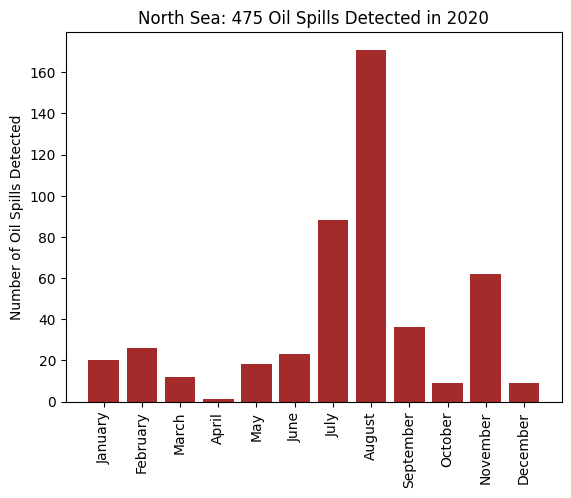

In [13]:
# Number of Oil Spills
number_oilspills = all_countries_gdf_allcat_clipped['posi_poly__id'].count()
print(
    'The total number of Oil Spills Detected in 2020 are'  f' {number_oilspills}')

# Convert 'grd__starttime' column to datetime type
all_countries_gdf_allcat_clipped['grd__starttime'] = pd.to_datetime(
    all_countries_gdf_allcat_clipped['grd__starttime'])

# Group by month in 'grd__starttime' column and calculate count of 'posi_poly__id'
result = all_countries_gdf_allcat_clipped.groupby(
    all_countries_gdf_allcat_clipped['grd__starttime'].dt.month)['posi_poly__id'].count()

# Get month names
month_names = [calendar.month_name[i] for i in result.index]

# Plot the bar graph
plt.bar(month_names, result.values, color='brown')
plt.xlabel('')
plt.ylabel('Number of Oil Spills Detected')
plt.title('North Sea: 475 Oil Spills Detected in 2020')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.show()

The total number of Oil Spills Detected in 2020 are 475


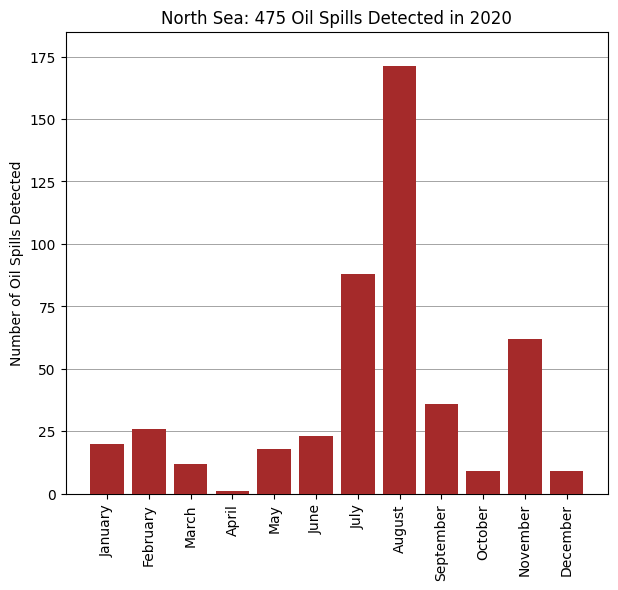

In [14]:
# Number of Oil Spills
number_oilspills = all_countries_gdf_allcat_clipped['posi_poly__id'].count()
print(
    'The total number of Oil Spills Detected in 2020 are' f' {number_oilspills}')

# Convert 'grd__starttime' column to datetime type
all_countries_gdf_allcat_clipped['grd__starttime'] = pd.to_datetime(
    all_countries_gdf_allcat_clipped['grd__starttime'])

# Group by month in 'grd__starttime' column and calculate count of 'posi_poly__id'
result = all_countries_gdf_allcat_clipped.groupby(
    all_countries_gdf_allcat_clipped['grd__starttime'].dt.month)['posi_poly__id'].count()

# Get month names
month_names = [calendar.month_name[i] for i in result.index]

# Plot the bar graph
fig, ax = plt.subplots(figsize=(7, 6))
bars = ax.bar(month_names, result.values, color='brown', zorder=3)
ax.set_xlabel('')
ax.set_ylabel('Number of Oil Spills Detected')
ax.set_title('North Sea: 475 Oil Spills Detected in 2020')
ax.set_xticks(month_names)
ax.set_xticklabels(month_names, rotation=90)  # Rotate x-axis labels
ax.grid(axis='y', color='grey', linestyle='-', linewidth=0.5, zorder=0)

# # Add the total number on top of each bar
# for bar in bars:
#     yval = bar.get_height()
#     ax.text(bar.get_x() + bar.get_width()/2, yval + 5, int(yval),
#             ha='center', va='bottom', zorder=4, fontsize=9)

# Set y-axis maximum limit
ax.set_ylim(0, 185)

plt.show()

### Number of oil spills detected per 10,000 km2 by country 

In [15]:
# Calculate the area in square kilometers and store it in the 'area_km2' column
all_countries_gdf_allcat_clipped['area_km2'] = (
    all_countries_gdf_allcat_clipped['geometry'].area / 1e6)

# Group the data by 'eez__geoname' and aggregate the count and sum
table = all_countries_gdf_allcat_clipped.groupby('eez__geoname').agg(
    {'eez__geoname': 'count', 'area_km2': 'sum'})

# Round the 'area_km2' values to one decimal place
table['area_km2'] = table['area_km2'].round(1)

# Rename the columns of the table
table.columns = ['Number of Oil Spills', 'Oil Spill Area (km2)']
table = table.rename_axis('Exclusive Economic Zone')

# Add a new column and fill it with manual values
manual_values = [47904, 324331, 14782, 733788]
table['EEZ Total Area (km2)'] = manual_values

# Add new column for number of spills by EEZ area
table['spills_by_EEZarea'] = table['Number of Oil Spills'] / \
    table['EEZ Total Area (km2)']

# Add new column for number of spills per 100,000 km2
table['spills_per_10k'] = table['spills_by_EEZarea']*10000

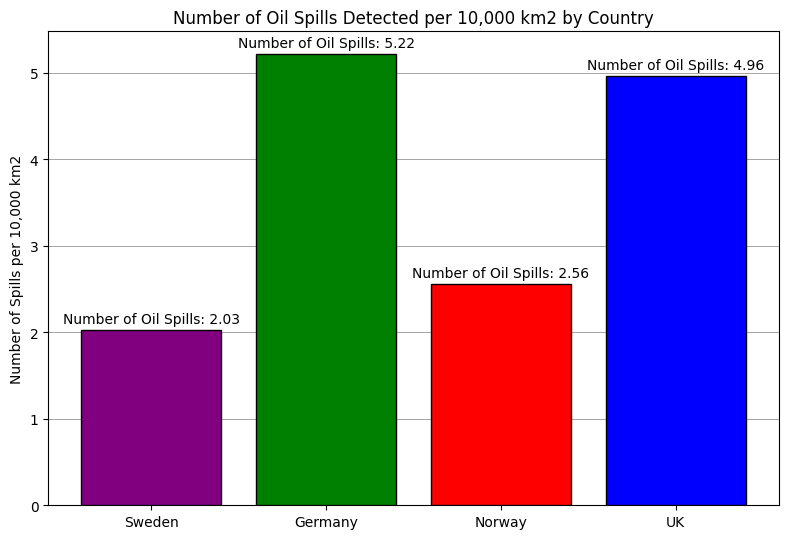

In [16]:
# Plot table data
data = {
    'EEZ': ["Sweden", 'Germany', 'Norway', 'UK'],
    'Oil Spills': [3, 25, 83, 128],
    'Total area (km2)': [3.4, 57.7, 209, 934.5],
    'Number of Spills per 10,000 km2': [2.03, 5.22, 2.56, 4.96]
}

df = pd.DataFrame(data)

# Create a new column in the DataFrame with the desired text
df['Text'] = 'Number of Oil Spills: ' + \
    df['Number of Spills per 10,000 km2'].astype(str)

# Plot
fig, ax = plt.subplots(figsize=(8, 5.5))
bars = ax.bar(df['EEZ'], df['Number of Spills per 10,000 km2'],
              color=['purple', 'green', 'red', 'blue'], zorder=3,
             edgecolor='black')

# Add data labels
for bar in bars:
    height = bar.get_height()
    ax.annotate(f'Number of Oil Spills: {height:.2f}',
                xy=(bar.get_x() + bar.get_width() / 2, height),
                xytext=(0, 3),  # 3 points vertical offset
                textcoords="offset points",
                ha='center', va='bottom')

ax.set_title('Number of Oil Spills Detected per 10,000 km2 by Country')
ax.set_ylabel('Number of Spills per 10,000 km2')
ax.set_xlabel('')
ax.grid(axis='y', color='grey', linestyle='-', linewidth=0.5, zorder=0)


plt.tight_layout()
plt.show()

Figure shows the number of oil spills by country per 10,000km2 of ocean.

### Wildlife affected by oil spills in 2020

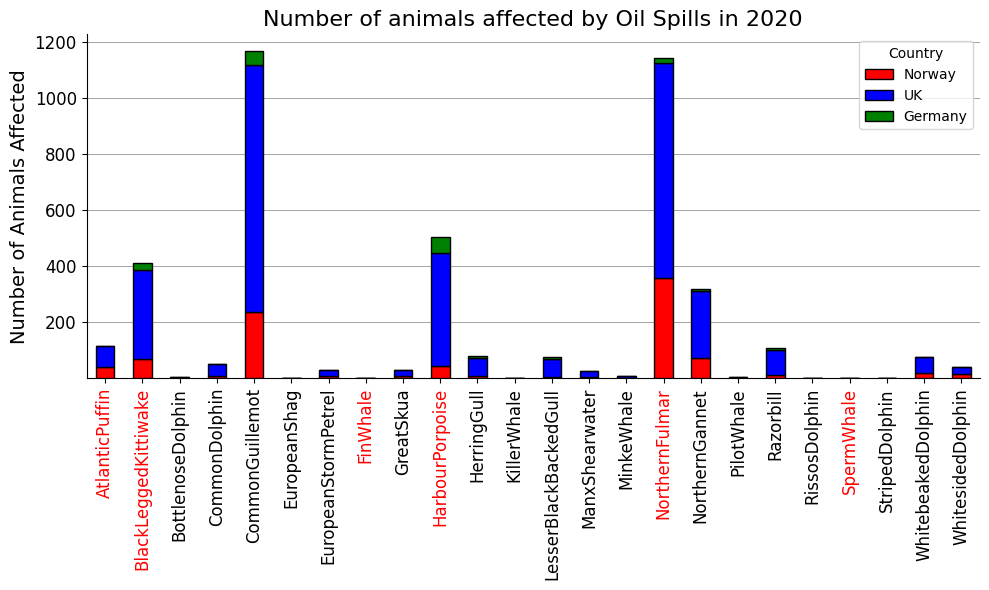

In [17]:
# Get available species IDs from data_dict keys
species_ids = sorted(
    list(set([k.split("_")[0] for k in data_dict.keys()])))

# Loop through all species_ids and gather the data
frames = []

for species_id in species_ids:
    # Loop through all the months to aggregate the data for the whole year for the given species_id
    monthly_frames = []
    for month in range(1, 13):
        monthly_frames.append(calculate_geometry_stats(
            data_dict, species_id, str(month).zfill(2), all_countries_gdf_allcat_clipped))

    # Concatenate monthly data to get yearly data for the given species_id
    result = pd.concat(monthly_frames)

    # Group by eez__geoname, then sum the densities
    grouped_data = result.groupby('eez__geoname')[
        'density'].sum().reset_index()
    # add species_id as a column to the dataframe
    grouped_data['species_id'] = species_id

    frames.append(grouped_data)

# Combine data for all species
all_species_data = pd.concat(frames)

# Pivot the data to have species_id as rows and eez__geoname as columns
pivoted_data = all_species_data.pivot(
    index='species_id', columns='eez__geoname', values='density').fillna(0)

# Filter for the desired countries that exist in the data
country_list = ['Norwegian Exclusive Economic Zone',
                'United Kingdom Exclusive Economic Zone',
                'German Exclusive Economic Zone',
                'Sweden Exclusive Economic Zone']
available_countries = [
    country for country in country_list if country in pivoted_data.columns]
pivoted_data = pivoted_data[available_countries]


# Create a stacked bar plot with customizations
fig, ax = plt.subplots(figsize=(10, 6))
pivoted_data.plot(kind='bar', stacked=True, ax=ax, color=[
                  'red', 'blue', 'green', 'orange'], edgecolor='black',
                 zorder=3)

ax.set_title("Number of animals affected by Oil Spills in 2020", fontsize=16)
ax.set_xlabel('', fontsize=14)
ax.set_ylabel('Number of Animals Affected', fontsize=14)

# Adjust x-axis label colors
highlight_species = ["AtlanticPuffin", "FinWhale", "BlackLeggedKittiwake",
                     "HarbourPorpoise", "NorthernFulmar", "SpermWhale"]
for label in ax.get_xticklabels():
    if label.get_text() in highlight_species:
        label.set_color('red')

# Customize the appearance of the plot
# ax.grid(True, linestyle='-', alpha=0.7, zorder=0)
ax.grid(axis='y', color='grey', linestyle='-', linewidth=0.5, zorder=0)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.tick_params(axis='both', which='major', labelsize=12)

# Rename the legend items
new_legend_labels = ['Norway', 'UK', 'Germany', 'Sweden']
ax.legend(new_legend_labels, loc='upper right', fontsize=10, title='Country')

plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

In [18]:
# Create dropdown widget for the species ID
species_id_dropdown = widgets.Dropdown(
    options=species_ids, description='Species ID')


@interact(species_id=species_id_dropdown)
def interactive_plot(species_id):
    # Month mapping
    month_map = {
        1: 'Jan', 2: 'Feb', 3: 'Mar', 4: 'Apr',
        5: 'May', 6: 'Jun', 7: 'Jul', 8: 'Aug',
        9: 'Sep', 10: 'Oct', 11: 'Nov', 12: 'Dec'
    }

    # Loop through all the months to aggregate the data for the whole year
    frames = []
    for month in range(1, 13):
        month_data = calculate_geometry_stats(data_dict, species_id, str(
            month).zfill(2), all_countries_gdf_allcat_clipped)
        # map the month number to its three-letter code
        month_data['month'] = month_map[month]
        frames.append(month_data)

    # Concatenate monthly data to get yearly data
    result = pd.concat(frames)

    # Group by month and eez__geoname, then sum the densities
    grouped_data = result.groupby(['month', 'eez__geoname'])[
        'density'].sum().reset_index()

    # Pivot the data to have months as rows and eez__geoname as columns
    pivoted_data = grouped_data.pivot(
        index='month', columns='eez__geoname', values='density').fillna(0)

    # Filter for the desired countries that exist in the data
    country_list = ['Norwegian Exclusive Economic Zone',
                    'United Kingdom Exclusive Economic Zone',
                    'German Exclusive Economic Zone',
                    'Sweden Exclusive Economic Zone']
    available_countries = [
        country for country in country_list if country in pivoted_data.columns]
    pivoted_data = pivoted_data[available_countries]

    # Create a stacked bar plot with customizations
    fig, ax = plt.subplots(figsize=(10, 6))
    pivoted_data.plot(kind='bar',
                      stacked=True,
                      ax=ax,
                      color=['red', 'blue', 'green', 'orange'],
                      edgecolor='black',
                      zorder=3)

    ax.set_title(
        f"{species_id} : Number of animals affected by Oil Spills", fontsize=16)
    ax.set_xlabel('Month', fontsize=14)
    ax.set_ylabel('Number of Animals Affected', fontsize=14)

    # Customize the appearance of the plot
    ax.grid(axis='y', color='grey', linestyle='-', linewidth=0.5, zorder=0)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.tick_params(axis='both', which='major', labelsize=12)
    # Rename the legend items
    new_legend_labels = ['Norway', 'UK', 'Germany', 'Sweden']
    ax.legend(new_legend_labels, loc='upper right',
              fontsize=10, title='Country')
    plt.xticks(rotation=0)
    plt.show()

interactive(children=(Dropdown(description='Species ID', options=('AtlanticPuffin', 'BlackLeggedKittiwake', 'B…

## Conclusion and Discussion

In this exploratory analysis, I have successfully demonstrated the potential of incorporating SkyTruth's Oil Spill SAR detection algorithm into a workflow for assessing the impact of oil spills originating from platforms and ships on the surrounding marine wildlife. Throughout August 2020, a total of 171 oil spills were detected from vessels and offshore infrastructure in the North Sea. While these incidents are not considered major oil spills, their cumulative effect on the environment is often underestimated, leading to significant harm to wildlife and ecosystems over time.

A comparative analysis of oil spills in the United Kingdom, Norway, and Germany revealed that the UK experienced the highest number of oil spills, affecting the largest areas. However, when considering the impact on a specific species, such as the Harbour porpoise, the UK was not necessarily the most destructive. Germany, with 10 oil spills covering a total area of 19.4 km2, had a smaller affected area compared to the UK. Nevertheless, these spills occurred in regions with higher densities of Harbour porpoise habitats, suggesting a potentially more significant impact on this species.

This key finding highlights the importance of considering not only the number and extent of oil spills but also their location in relation to specific species' habitats. In the case of the Harbour porpoise, even smaller spills can have considerable consequences on their health and well-being. The integration of SkyTruth's Oil Spill SAR detection algorithm into the workflow allows for a more comprehensive understanding of the effects of oil spills on marine wildlife, enabling more effective conservation and management strategies.


## Future Research and Next Steps

The present study serves as a preliminary use case for a more comprehensive tool I plan to develop. Utilizing one month of data and focusing on a single species, I was able to validate the workflow and obtain intriguing findings. Building upon these initial results, I will expand the scope of the research to incorporate oil spill data from the entire year (January through December 2020) and examine the effects on 12 marine mammal species' distributions on a monthly basis.

This enhanced tool will provide valuable insights into the direct impact of small oil spills from offshore infrastructure and vessels in the North Sea on the habitats of 12 marine mammal species. By broadening the dataset and considering a wider range of species, the refined tool will contribute to a more accurate understanding of the complex interplay between oil spills and marine ecosystems, as well as inform more effective conservation and management strategies.

Future research could also explore the integration of additional data sources, such as oceanographic and meteorological parameters, to better account for environmental conditions that may influence the dispersal and impact of oil spills. Moreover, expanding the geographical scope of the study and applying the developed tool to other regions would enhance the generalizability and applicability of my findings, ultimately contributing to the global efforts in protecting marine wildlife from the detrimental effects of oil spills.
